<a href="https://colab.research.google.com/github/ziadbwdn/ProjectDataViz/blob/main/Muhammad_Ziad_Project_Pacmann_DataVizWra_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Muhammad Ziad - Project Pacmann AI - Data Visualization and Wrangling Class**

 **Importing module**

In [ ]:
pip install pandas-profiling[notebook]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 9.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.2 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=81d562f3b91f3fb41bab349ffef74f126bf04def53f40af1ac0b52aaa59a8154
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
pip show pandas-profiling

Name: pandas-profiling
Version: 3.6.6
Summary: Deprecated 'pandas-profiling' package, use 'ydata-profiling' instead
Home-page: https://github.com/ydataai/pandas-profiling
Author: YData Labs Inc
Author-email: opensource@ydata.ai
License: MIT
Location: /usr/local/lib/python3.10/dist-packages
Requires: ydata-profiling
Required-by: 


In [ ]:
pip install ydata-profiling

In [ ]:
import ydata_profiling as yp

In [ ]:
#General modules
import numpy as np
import pandas as pd
from tqdm import *

#For plotting
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider, Button
import seaborn as sns

#For dealing with time string types
import datetime

#For Exploratory Data Analysis (EDA)
from ydata_profiling import ProfileReport

In [ ]:
# Load the Drive helper and mount
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Data loading**

In [ ]:
df = pd.read_csv('/content/drive/My Drive/ProjectPacmann/AirQuality.csv', sep = ';', decimal = ',')
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,10/03/2004,18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,NaN,NaN
1,10/03/2004,19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,NaN,NaN
2,10/03/2004,20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,NaN,NaN
3,10/03/2004,21.00.00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,NaN,NaN
4,10/03/2004,22.00.00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,NaN,NaN


Removing unnamed columns

In [ ]:
df.drop(['Unnamed: 15','Unnamed: 16'], axis=1, inplace=True, errors = 'ignore')
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,10/03/2004,21.00.00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,10/03/2004,22.00.00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


**Removing Null/Faulty Sensor Readings**

In [ ]:
#Replacing bad sensor readings designated by an entry of -200 with NaN

df.replace(to_replace = -200, value = np.nan, inplace = True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         7674 non-null   float64
 3   PT08.S1(CO)    8991 non-null   float64
 4   NMHC(GT)       914 non-null    float64
 5   C6H6(GT)       8991 non-null   float64
 6   PT08.S2(NMHC)  8991 non-null   float64
 7   NOx(GT)        7718 non-null   float64
 8   PT08.S3(NOx)   8991 non-null   float64
 9   NO2(GT)        7715 non-null   float64
 10  PT08.S4(NO2)   8991 non-null   float64
 11  PT08.S5(O3)    8991 non-null   float64
 12  T              8991 non-null   float64
 13  RH             8991 non-null   float64
 14  AH             8991 non-null   float64
dtypes: float64(13), object(2)
memory usage: 1.1+ MB


As we can look above, Column 4 ('NMCH') has a lot of faulty readings relative to all the other sensors. Let
me determine what the percent composition is of nulls with respect to the total values. This will help me
determine whether to keep that column or drop it.

In [ ]:
percent_NaN = []
columns = df.columns
for col in columns:
    pNaN =  (df[col].isna().sum()/df.shape[0]) * 100 #sum NaN instances in each column. Divide by total rows
    percent_NaN.append(pNaN)
nan_percent_df = pd.DataFrame(percent_NaN,
                              index=columns,
                              columns=['%_NaN_in_Column']).sort_values('%_NaN_in_Column',ascending = False)
nan_percent_df

,%_NaN_in_Column
NMHC(GT),90.349488
CO(GT),18.973709
NO2(GT),18.540809
NOx(GT),18.509133
PT08.S1(CO),5.068103
C6H6(GT),5.068103
PT08.S2(NMHC),5.068103
PT08.S3(NOx),5.068103
PT08.S4(NO2),5.068103
PT08.S5(O3),5.068103


More than 90% of the entries in that columns are null. If I were to use the dropna method on the entire
dataset **I'd end up losing 90% of our data**. We do still have a column with information about
Benzene (C6H6) concentrations through the columns C6H6(GT) and
PT08.S2 (NMHCH), so we haven't completely lost the entirety of the hydrocarbon readings. Instead, I will opt for
dropping this feature from the dataset, dropping the NaN rows and press forward.

In [ ]:
df.drop('NMHC(GT)', axis=1, inplace=True, errors = 'ignore')
df = df.dropna()
df.head()

,Date,Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,10/03/2004,21.00.00,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,10/03/2004,22.00.00,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6941 entries, 0 to 9356
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           6941 non-null   object 
 1   Time           6941 non-null   object 
 2   CO(GT)         6941 non-null   float64
 3   PT08.S1(CO)    6941 non-null   float64
 4   C6H6(GT)       6941 non-null   float64
 5   PT08.S2(NMHC)  6941 non-null   float64
 6   NOx(GT)        6941 non-null   float64
 7   PT08.S3(NOx)   6941 non-null   float64
 8   NO2(GT)        6941 non-null   float64
 9   PT08.S4(NO2)   6941 non-null   float64
 10  PT08.S5(O3)    6941 non-null   float64
 11  T              6941 non-null   float64
 12  RH             6941 non-null   float64
 13  AH             6941 non-null   float64
dtypes: float64(12), object(2)
memory usage: 813.4+ KB


**Formatting time features for analysis purposes**

In [ ]:
df['DateTime'] =  (df.Date) + ' ' + (df.Time)
df.DateTime = df.DateTime.apply(lambda x: datetime.datetime.strptime(x, '%d/%m/%Y %H.%M.%S'))
df

,Date,Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,DateTime
0,10/03/2004,18.00.00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004-03-10 18:00:00
1,10/03/2004,19.00.00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004-03-10 19:00:00
2,10/03/2004,20.00.00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004-03-10 20:00:00
3,10/03/2004,21.00.00,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,2004-03-10 21:00:00
4,10/03/2004,22.00.00,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,2004-03-10 22:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9352,04/04/2005,10.00.00,3.1,1314.0,13.5,1101.0,472.0,539.0,190.0,1374.0,1729.0,21.9,29.3,0.7568,2005-04-04 10:00:00
9353,04/04/2005,11.00.00,2.4,1163.0,11.4,1027.0,353.0,604.0,179.0,1264.0,1269.0,24.3,23.7,0.7119,2005-04-04 11:00:00
9354,04/04/2005,12.00.00,2.4,1142.0,12.4,1063.0,293.0,603.0,175.0,1241.0,1092.0,26.9,18.3,0.6406,2005-04-04 12:00:00
9355,04/04/2005,13.00.00,2.1,1003.0,9.5,961.0,235.0,702.0,156.0,1041.0,770.0,28.3,13.5,0.5139,2005-04-04 13:00:00


In [ ]:
df['Weekday'] = df['DateTime'].dt.day_name()
df['Month']   = df['DateTime'].dt.month_name()
df['Hour']    = df['DateTime'].dt.hour
df['Date']    = pd.to_datetime(df['Date'], format='%d/%m/%Y')
df.drop('Time', axis=1, inplace=True, errors = 'ignore')
df.head()

,Date,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,DateTime,Weekday,Month,Hour
0,2004-03-10,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004-03-10 18:00:00,Wednesday,March,18
1,2004-03-10,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004-03-10 19:00:00,Wednesday,March,19
2,2004-03-10,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004-03-10 20:00:00,Wednesday,March,20
3,2004-03-10,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,2004-03-10 21:00:00,Wednesday,March,21
4,2004-03-10,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,2004-03-10 22:00:00,Wednesday,March,22


In [ ]:
df = df[['Date','Month', 'Weekday','DateTime', 'Hour', 'CO(GT)','PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)',
         'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)', 'T', 'RH', 'AH']]
df.head()

,Date,Month,Weekday,DateTime,Hour,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2004-03-10,March,Wednesday,2004-03-10 18:00:00,18,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,2004-03-10,March,Wednesday,2004-03-10 19:00:00,19,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,2004-03-10,March,Wednesday,2004-03-10 20:00:00,20,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,2004-03-10,March,Wednesday,2004-03-10 21:00:00,21,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,2004-03-10,March,Wednesday,2004-03-10 22:00:00,22,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6941 entries, 0 to 9356
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Date           6941 non-null   datetime64[ns]
 1   Month          6941 non-null   object        
 2   Weekday        6941 non-null   object        
 3   DateTime       6941 non-null   datetime64[ns]
 4   Hour           6941 non-null   int32         
 5   CO(GT)         6941 non-null   float64       
 6   PT08.S1(CO)    6941 non-null   float64       
 7   C6H6(GT)       6941 non-null   float64       
 8   PT08.S2(NMHC)  6941 non-null   float64       
 9   NOx(GT)        6941 non-null   float64       
 10  PT08.S3(NOx)   6941 non-null   float64       
 11  NO2(GT)        6941 non-null   float64       
 12  PT08.S4(NO2)   6941 non-null   float64       
 13  PT08.S5(O3)    6941 non-null   float64       
 14  T              6941 non-null   float64       
 15  RH             6941 non-nu

**Checkpoint for DataFrame Profiling**

These are the data features that we have at our tools from this dataset:
Date (dd/mm/yyyy)

*   Time (hh:mm:ss)
*   True hourly averaged concentration CO in mg/m^3 (reference analyzer)
*   PT08.S1 (tin oxide) hourly averaged sensor response (nominally CO targeted)
*   True hourly averaged overall Non-metallic HydroCarbons concentration in mg/m^3 (reference
analyzer)
*   True hourly averaged Benzene concentration in microg/m^3 (reference analyzer)
*   PT08.S2 (titania) hourly averaged sensor response (nominally NMHC targeted)
*   PT08.S3 (tungsten oxide) hourly averaged sensor response (nominally NOx targeted)
*   True hourly averaged NO2 concentration in microg/m^3 (reference analyzer)
*   PT08.S4 (tungsten oxide) hourly averaged sensor response (nominally NO2 targeted)
*   PT08.S5 (indium oxide) hourly averaged sensor response (nominally O3 targeted)
*   Temperature in °C
*   Relative Humidity (&)
*   AH Absolute Humidity

**Use pandas profiling to quickly get a quick overview
of what variables would be interesting to explore**

In [ ]:
df.reset_index(drop=True, inplace=True) #Drop index prior to generating report
report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

There's a few interesting things that report has shown.

In particular, it can be seen that all the pollutant concentrations detected by the sensors are highly
correlated with one another. Interestingly, for some reason the readings from the sensor 'PT08.S3(NOx)' are
anticorrelated with one another. This would suggest that the levels of Nitrous Oxide(s) are decreasing with
increasing levels of the other pollutants. Why would this be? Is this a real effect?

Other things that are noteworthy are the distribution shapes for each variable. Most of them appear to have
approximately unimodal distributions (that also show right-skewedness). Some of the exceptions are
PT08.S4 (NO2) are AH where there is fairly clear bimodal behavior occurring. This suggests that there is
further cleaning up that I need to do since skewedness in a distribution is related to the presence of outliers

**Outliers removing**

In [ ]:
# Removing Outliers with the Interquartile Range Method (IQR)

Q1 = df.quantile(0.25, numeric_only=True)  # First quartile (25%)
Q3 = df.quantile(0.75, numeric_only=True)  # Third quartile (75%)


IQR = Q3 - Q1 # IQR = InterQuartile Range

scale = 1.4 # May need to play with this value to modify outlier detection sensitivity if need be
lower_lim = Q1 - scale*IQR
upper_lim = Q3 + scale*IQR

cols = df.columns[5:]  # Look for outliers in columns starting from CO(GT)

# Align lower_lim and upper_lim with the DataFrame columns
lower_lim = lower_lim[cols]
upper_lim = upper_lim[cols]

# Mask a condition that removes rows with values above/below IQR limits
condition = ~((df[cols] < lower_lim) | (df[cols] > upper_lim)).any(axis=1)

# Generate a new DataFrame with outliers removed
df_filtered = df[condition]

In [ ]:
df_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6099 entries, 0 to 6940
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Date           6099 non-null   datetime64[ns]
 1   Month          6099 non-null   object        
 2   Weekday        6099 non-null   object        
 3   DateTime       6099 non-null   datetime64[ns]
 4   Hour           6099 non-null   int32         
 5   CO(GT)         6099 non-null   float64       
 6   PT08.S1(CO)    6099 non-null   float64       
 7   C6H6(GT)       6099 non-null   float64       
 8   PT08.S2(NMHC)  6099 non-null   float64       
 9   NOx(GT)        6099 non-null   float64       
 10  PT08.S3(NOx)   6099 non-null   float64       
 11  NO2(GT)        6099 non-null   float64       
 12  PT08.S4(NO2)   6099 non-null   float64       
 13  PT08.S5(O3)    6099 non-null   float64       
 14  T              6099 non-null   float64       
 15  RH             6099 non-nu

Profile checking

In [ ]:
df_filtered.reset_index(drop=True, inplace=True) #Drop index prior to generating report
report = ProfileReport(df_filtered)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Now the data is free from the outliers

Let's move to another segment, which is dealing with skewedness of the data and how to treat them

> Add blockquote



**Drop the unnecessary data**

In [ ]:
df_filtered.drop(['CO(GT)']  ,axis=1, inplace=True, errors = 'ignore')
df_filtered.drop(['NOx(GT)'] ,axis=1, inplace=True, errors = 'ignore')
df_filtered.drop(['C6H6(GT)'],axis=1, inplace=True, errors = 'ignore')
df_filtered.drop(['NO2(GT)'] ,axis=1, inplace=True, errors = 'ignore')
df_filtered.head()

<ipython-input-31-cb50782a70c7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.drop(['CO(GT)']  ,axis=1, inplace=True, errors = 'ignore')
<ipython-input-31-cb50782a70c7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.drop(['NOx(GT)'] ,axis=1, inplace=True, errors = 'ignore')
<ipython-input-31-cb50782a70c7>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.drop(['C6H6(GT)'],axis=1, inplace=True, er

,Date,Month,Weekday,DateTime,Hour,PT08.S1(CO),PT08.S2(NMHC),PT08.S3(NOx),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2004-03-10,March,Wednesday,2004-03-10 18:00:00,18,1360.0,1046.0,1056.0,1692.0,1268.0,13.6,48.9,0.7578
1,2004-03-10,March,Wednesday,2004-03-10 19:00:00,19,1292.0,955.0,1174.0,1559.0,972.0,13.3,47.7,0.7255
2,2004-03-10,March,Wednesday,2004-03-10 20:00:00,20,1402.0,939.0,1140.0,1555.0,1074.0,11.9,54.0,0.7502
3,2004-03-10,March,Wednesday,2004-03-10 21:00:00,21,1376.0,948.0,1092.0,1584.0,1203.0,11.0,60.0,0.7867
4,2004-03-10,March,Wednesday,2004-03-10 22:00:00,22,1272.0,836.0,1205.0,1490.0,1110.0,11.2,59.6,0.7888


**generate the final report before continuing to check the state of data itself**

In [ ]:
df_filtered.reset_index(drop=True, inplace=True) #Drop index prior to generating report
report = ProfileReport(df_filtered)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Time Series on Air Quality Data**

In [ ]:
month_df_list = []
day_df_list   = []
hour_df_list  = []

months = ['January','February','March', 'April', 'May','June',
          'July', 'August', 'September', 'October', 'November', 'December']

days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

for month in months:
    temp_df = df_filtered.loc[(df_filtered['Month'] == month)]
    month_df_list.append(temp_df)

for day in days:
    temp_df = df_filtered.loc[(df_filtered['Weekday'] == day)]
    day_df_list.append(temp_df)

for hour in range(24):
    temp_df = df_filtered.loc[(df_filtered['Hour'] == hour)]
    hour_df_list.append(temp_df)

In [ ]:
def df_time_plotter(df_list, time_unit, y_col):

    months = ['January','February','March', 'April', 'May','June',
              'July', 'August', 'September', 'October', 'November', 'December']

    days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

    if time_unit == 'M':
        nRows = 3
        nCols = 4
        n_iter = len(months)
    elif time_unit == 'D':
        nRows = 2
        nCols = 4
        n_iter = len(days)
    elif time_unit == 'H':
        nRows = 4
        nCols = 6
        n_iter = 24
    else:
        print('time_unit must be a string equal to M,D, or H')
        return 0

    fig, axs = plt.subplots(nrows=nRows, ncols=nCols, figsize = (40,30))
    axs = axs.ravel()
    for i in range(n_iter):
        data = df_list[i]
        ax = axs[i]
        data.plot(kind ='scatter', x = 'DateTime', y= y_col , ax = ax, fontsize = 24)
        ax.set_ylabel('Pollutant Concentration',fontsize=30)
        ax.set_xlabel('')
        if time_unit == 'M':
            ax.set_title(y_col + ' ' + months[i],  size=40) # Title
        elif time_unit == 'D':
            ax.set_title(y_col + ' ' + days[i],  size=40) # Title
        else:
             ax.set_title(y_col + ' ' + str(i),  size=40) # Title
        ax.tick_params(labelrotation=60)

        #plt.xlim([datetime.date(2004, 3, 10), datetime.date(2004, 3, 30)])
    # set the spacing between subplots
    plt.subplots_adjust(left=0.1,
                    bottom=0.1,
                    right=0.9,
                    top=0.9,
                    wspace=0.4,
                    hspace=0.5)
    plt.show() # Depending on whether you use IPython or interactive mode, etc.

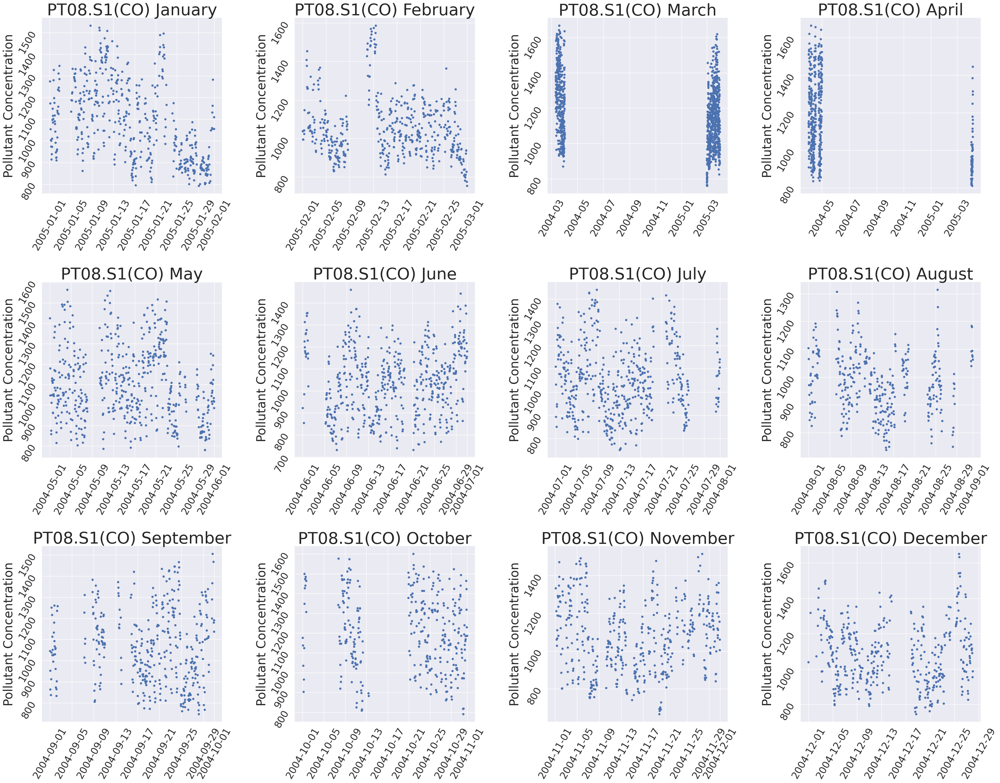

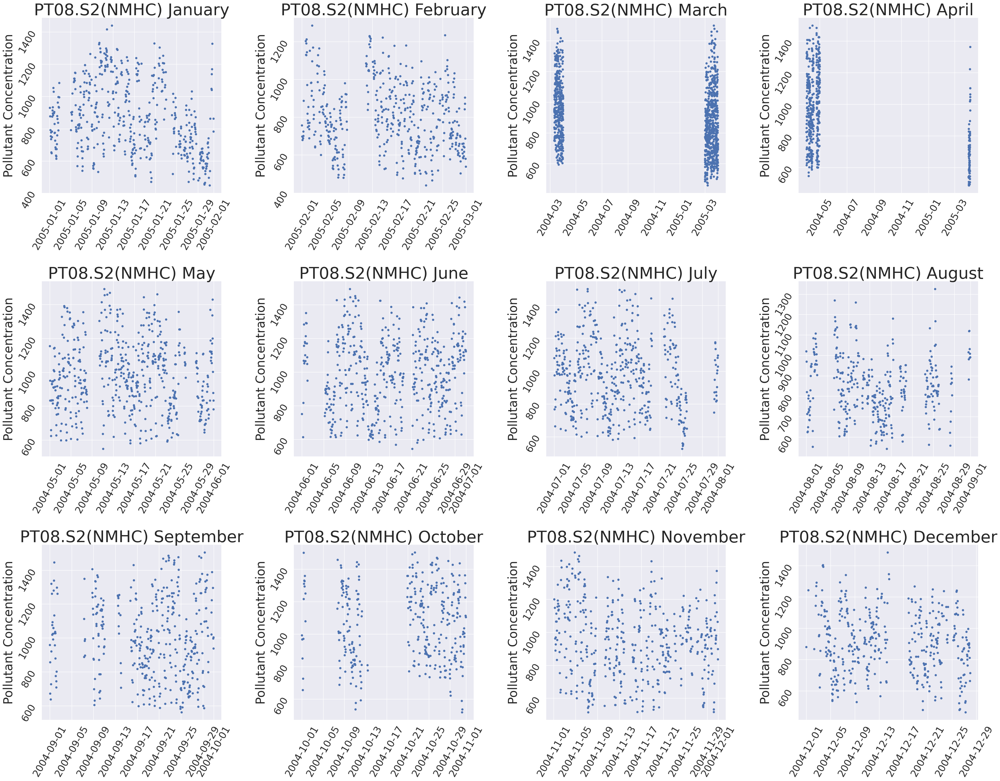

In [ ]:
df_time_plotter(month_df_list,'M','PT08.S1(CO)')
df_time_plotter(month_df_list,'M','PT08.S2(NMHC)')

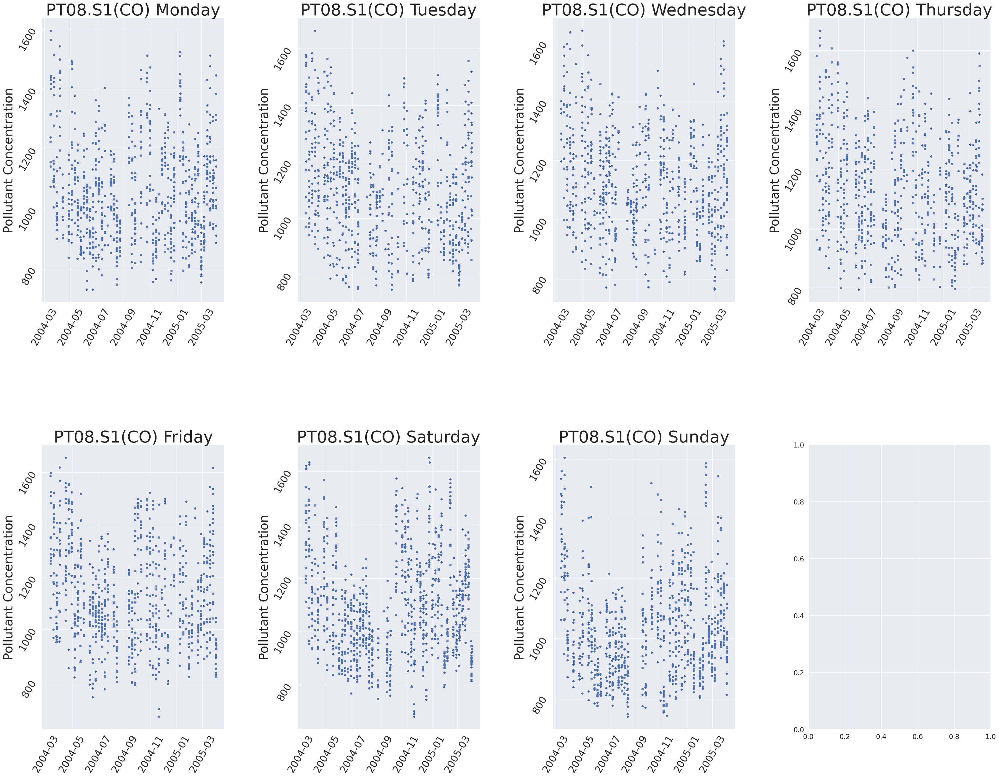

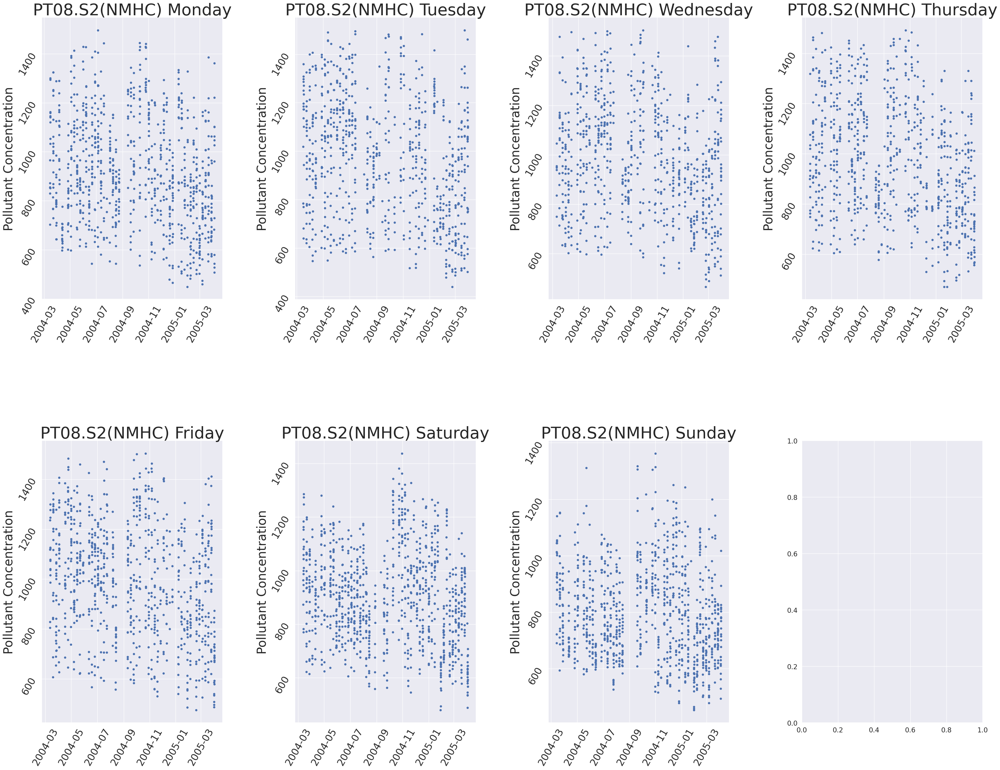

In [ ]:
df_time_plotter(day_df_list,'D','PT08.S1(CO)')
df_time_plotter(day_df_list,'D','PT08.S2(NMHC)')

In [ ]:
df_time_plotter(hour_df_list,'H','PT08.S1(CO)')
df_time_plotter(hour_df_list,'H','PT08.S2(NMHC)')

NameError: name 'df_time_plotter' is not defined

It looks like readings are quite low between 4-6 AM. The CO levels rise starting at 1PM and peak at around 6-8pm. Maybe a bar plot will make some of these relationships more apparent

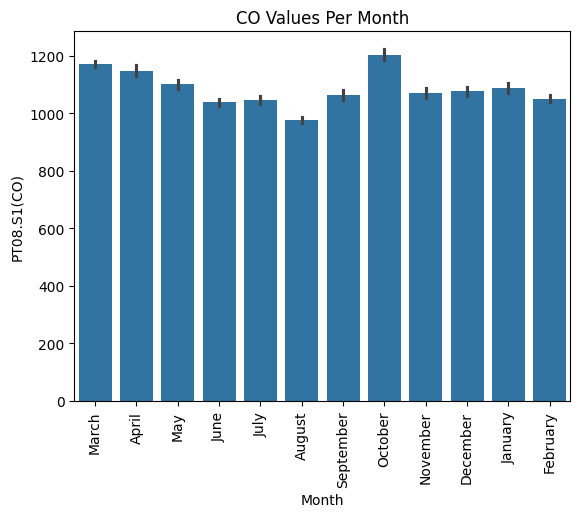

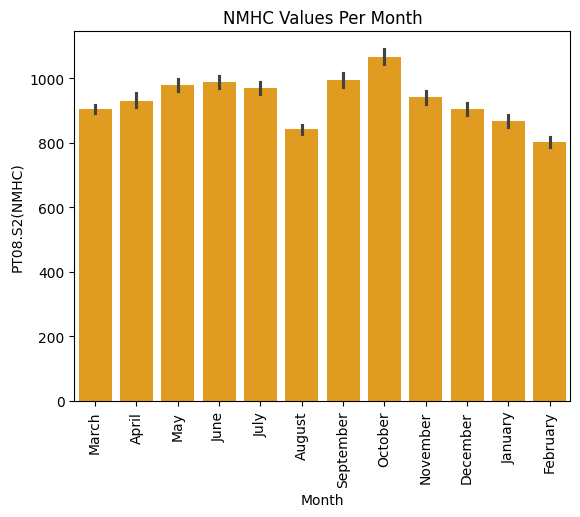

In [ ]:
sns.barplot(x = 'Month', y = 'PT08.S1(CO)', data = df_filtered)
plt.title('CO Values Per Month')
plt.xticks(rotation=90)
plt.show()

sns.barplot(x = 'Month', y = 'PT08.S2(NMHC)', data = df_filtered, color='orange')
plt.title('NMHC Values Per Month')
plt.xticks(rotation=90)
plt.show()

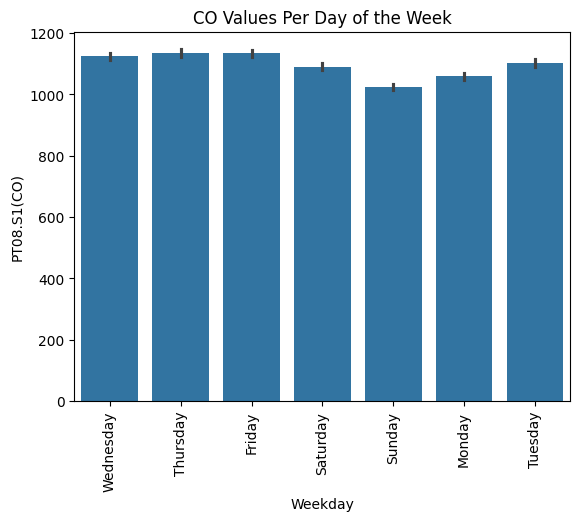

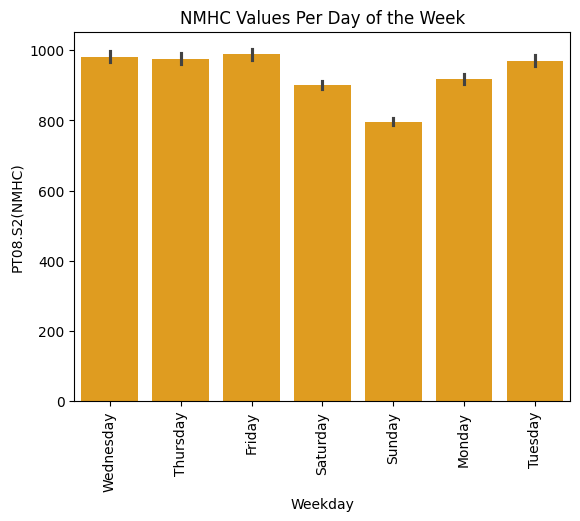

In [ ]:
sns.barplot(x = 'Weekday', y = 'PT08.S1(CO)', data = df_filtered)
plt.title('CO Values Per Day of the Week')
plt.xticks(rotation=90)
plt.show()

sns.barplot(x = 'Weekday', y = 'PT08.S2(NMHC)', data = df_filtered, color ='orange')
plt.title('NMHC Values Per Day of the Week')
plt.xticks(rotation=90)
plt.show()

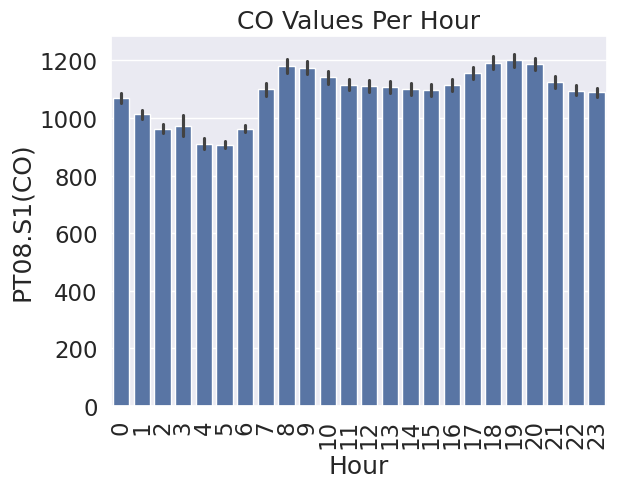

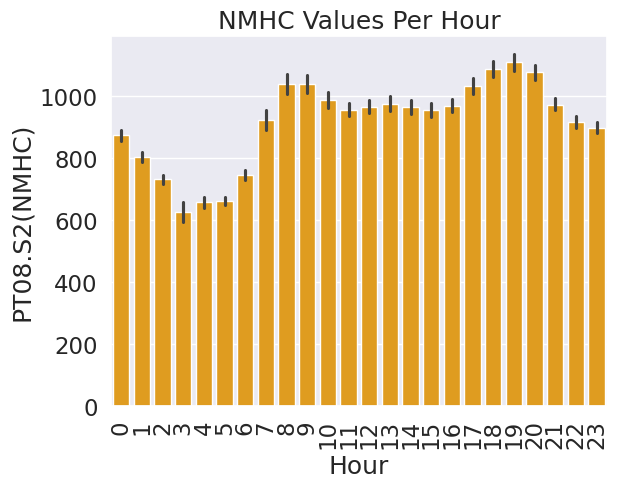

In [ ]:
sns.barplot(x = 'Hour', y = 'PT08.S1(CO)', data = df_filtered)
plt.title('CO Values Per Hour')
plt.xticks(rotation=90)
plt.show()

sns.barplot(x = 'Hour', y = 'PT08.S2(NMHC)', data = df_filtered, color='orange')
plt.title('NMHC Values Per Hour')
plt.xticks(rotation=90)
plt.show()

In [ ]:
df_final = df_filtered.iloc[:, 5:]
df_final

,PT08.S1(CO),PT08.S2(NMHC),PT08.S3(NOx),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,1360.0,1046.0,1056.0,1692.0,1268.0,13.6,48.9,0.7578
1,1292.0,955.0,1174.0,1559.0,972.0,13.3,47.7,0.7255
2,1402.0,939.0,1140.0,1555.0,1074.0,11.9,54.0,0.7502
3,1376.0,948.0,1092.0,1584.0,1203.0,11.0,60.0,0.7867
4,1272.0,836.0,1205.0,1490.0,1110.0,11.2,59.6,0.7888
...,...,...,...,...,...,...,...,...
6094,1314.0,1101.0,539.0,1374.0,1729.0,21.9,29.3,0.7568
6095,1163.0,1027.0,604.0,1264.0,1269.0,24.3,23.7,0.7119
6096,1142.0,1063.0,603.0,1241.0,1092.0,26.9,18.3,0.6406
6097,1003.0,961.0,702.0,1041.0,770.0,28.3,13.5,0.5139


This is a lot clearer.

From these plots we can see the following:

*   October has the highest CO readings while August had the lowest readings.
*   CO levels trend downward from October to August. They start to rise between August to October.
*   CO levels are lowest on Sundays and highest on Friday
*   CO levels are lowest between 4-5 AM and highest at 8 AM and 7 PM. This makes sense since these are rush hour times.

Let me generate a pairplot to get a better grasp of all these relationships.

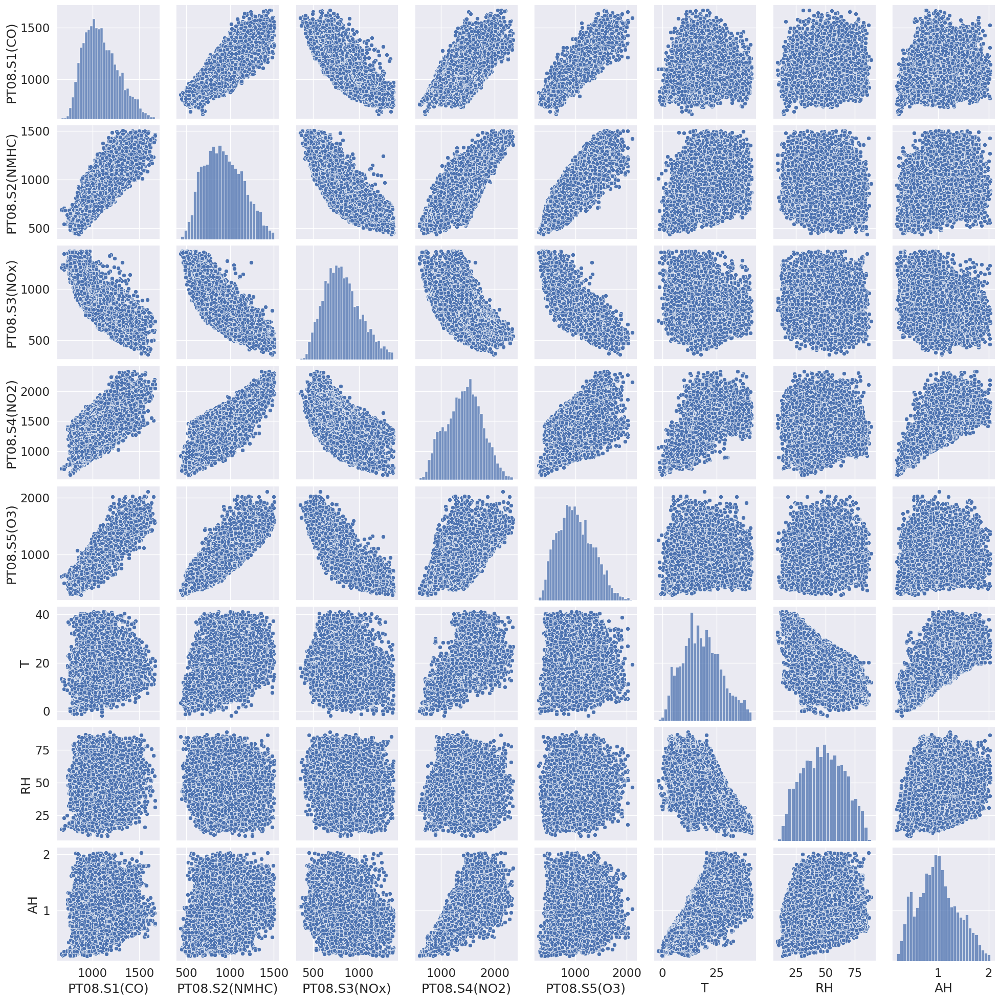

In [ ]:
sns.set(font_scale=1.5)
sns.pairplot(df_final)

In [ ]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6099 entries, 0 to 6098
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   PT08.S1(CO)    6099 non-null   float64
 1   PT08.S2(NMHC)  6099 non-null   float64
 2   PT08.S3(NOx)   6099 non-null   float64
 3   PT08.S4(NO2)   6099 non-null   float64
 4   PT08.S5(O3)    6099 non-null   float64
 5   T              6099 non-null   float64
 6   RH             6099 non-null   float64
 7   AH             6099 non-null   float64
dtypes: float64(8)
memory usage: 381.3 KB
